# Self-Driving Car Engineer Nanodegree

## Project: Build a Traffic Sign Recognition Classifier

---
## Overview
The goal of this project is to write a software pipeline to identify the lane boundaries in a video. The following animation shows how the pipeline detects the lane.

[Animation Place holder]()

My lane detection pipeline consists of the following steps:
1. Compute camera calibration matrix and distortion coefficients.
1. Undistort raw images.
1. Use color transforms, gradients, etc., to create a thresholded binary image.
1. Transform image to "birds-eye view".
1. Detect lane pixels and fit to find the lane boundary.
1. Determine the curvature of the lane and vehicle position with respect to center.
1. Warp the detected lane boundaries back onto the original image.
1. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


### Computing camera calibration matrix
Using the chess borad images in the *camera_cal/* folder and the calibrateCamera function from opencv, we could get the following calibration matrix:  

In [15]:
"""
Finding the correction matrix and distortion coefficients
"""

import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib qt

nx = 9
ny = 6

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
image_names = glob.glob('camera_cal/calibration*.jpg')
image_names.sort()

# Step through the list and search for chessboard corners
for idx, fname in enumerate(image_names):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_size = (img.shape[1], img.shape[0])
    
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        cv2.drawChessboardCorners(img, (nx,ny), corners, ret)

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
print(mtx)

[[  1.23838205e+03   0.00000000e+00   6.80443224e+02]
 [  0.00000000e+00   1.26242821e+03   4.04865469e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]


### Undistort raw images
After we computed the calibration matrix we could use it to undistort the image.  

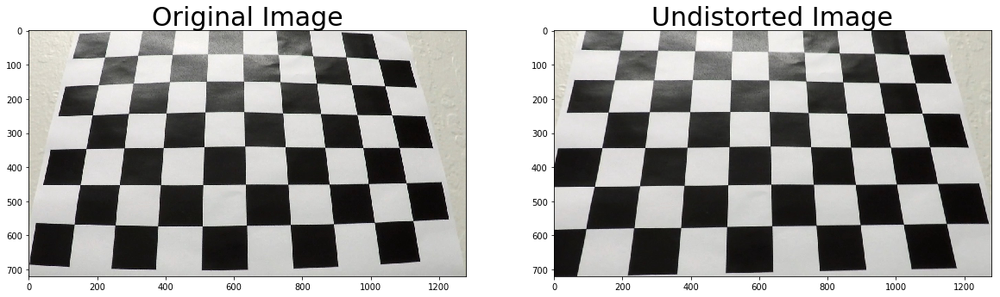

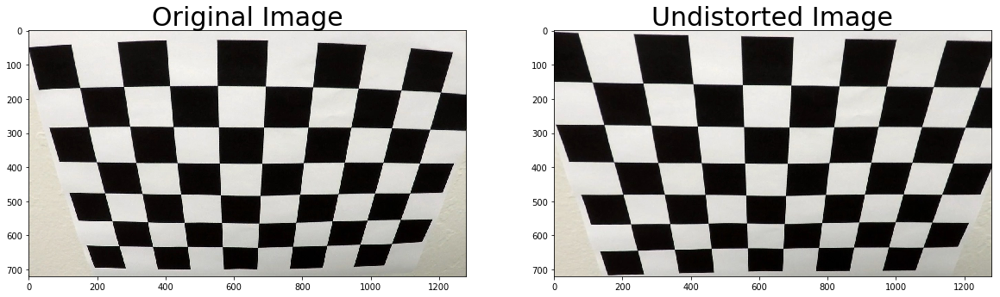

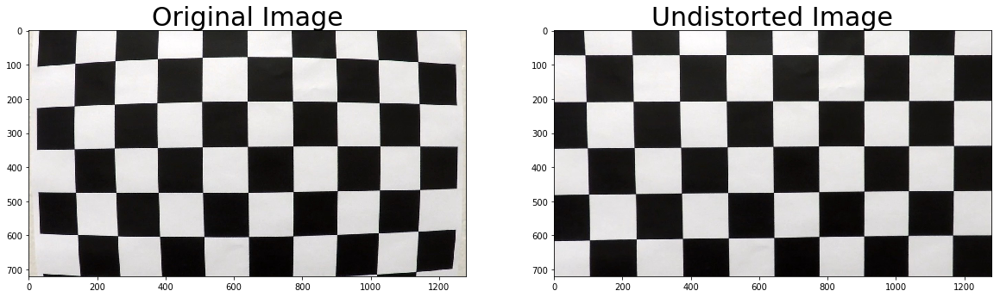

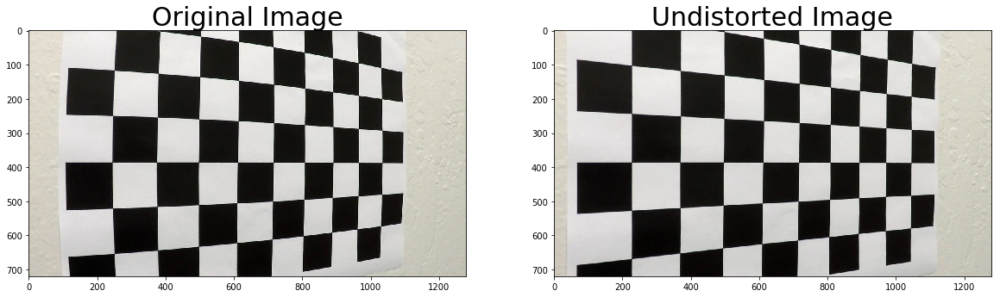

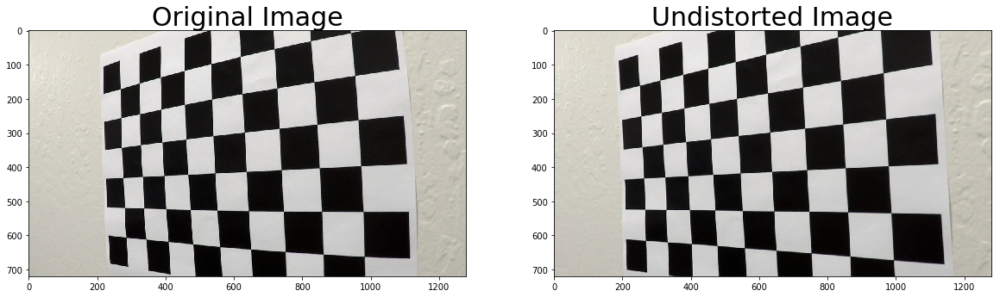

In [16]:
"""
Undistort the images
"""

import pickle
import os
%matplotlib inline

def undistort(mtx, dist, img_in_path, img_out_path='', plot=False):
    # Test undistortion on an image
    img = cv2.imread(img_in_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_size = (img.shape[1], img.shape[0])
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    if img_out_path:
        cv2.imwrite(img_out_path,dst)
    
    if plot:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=30)
        ax2.imshow(dst)
        ax2.set_title('Undistorted Image', fontsize=30)
    return dst

image_in_folder = 'camera_cal/'
image_out_folder = 'camera_cal_output/'
files = [x for x in os.listdir(image_in_folder) if x.endswith('.jpg')]
chessboard_undists = []
for file in files:
    chessboard_undists.append(undistort(mtx,dist,
                              os.path.join(image_in_folder,file),
                              os.path.join(image_out_folder,file),
                              plot=True))

### Perspective transform
To convert perspective of the image to "bird's eye view". We need to define the source and target points on the image. In the chess board case, we could simply take advantage of the *findChessboardCorners()* function in cv2 to automatically define the source coner points. The following code shows how I tranform the perspective of the chess board image.

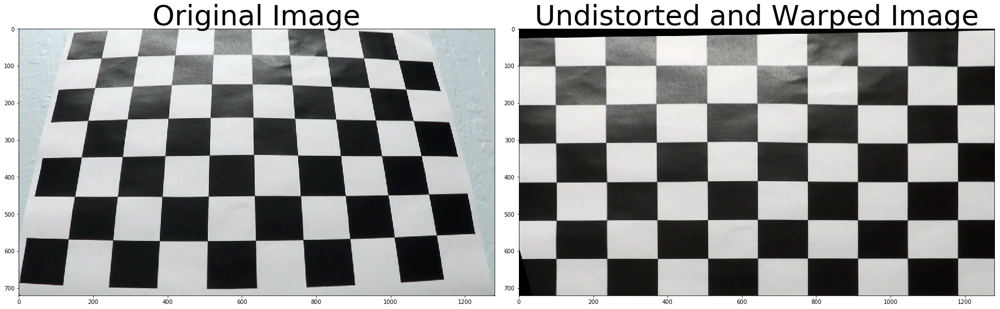

In [17]:
"""
Transform image perspective
"""

def corners_unwarp(img, nx, ny, mtx, dist):
    img_size = (img.shape[1], img.shape[0])
    img1 = cv2.undistort(img, mtx, dist, None, mtx)
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    ret, corners = cv2.findChessboardCorners(img1, (nx, ny), None)
    warped,M = None,None
    if ret == True:
        src = np.float32([corners[0][0],corners[nx-1][0],corners[-1][0],corners[-nx][0]])
        offset = 100 # offset for dst points
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                 [img_size[0]-offset, img_size[1]-offset], 
                                 [offset, img_size[1]-offset]])
        M = cv2.getPerspectiveTransform(src, dst)
        warped = cv2.warpPerspective(img1, M, img_size, flags=cv2.INTER_LINEAR)
    else:
        raise Exception("Can't find given number of corners in the images")
    return warped, M

img = cv2.imread(os.path.join(image_in_folder,files[0]))
top_down, perspective_M = corners_unwarp(img, nx, ny, mtx, dist)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(top_down)
ax2.set_title('Undistorted and Warped Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

But in the case of lane finding, there is no corners like chessboard so we need to define our own source and target points. Assuming the ground is flat, I selected a trapozoidal shape in the image as the source points and a rectangle shape as the target points.

In [18]:
# X,Y
img_size = (1280, 720)
            
# MMa 2017-06-27 Why it failed immediately when top source points are less then half of the height ??!
src = np.float32([ [img_size[0]/2-116,img_size[1]/2+150],
                    [img_size[0]/2+116,img_size[1]/2+150],
                    [img_size[0]/2+320,img_size[1]],
                    [img_size[0]/2-320,img_size[1]]])

offset_x = 300 # offset for dst points
offset_y = 400
dst = np.float32([ [offset_x, offset_y], 
                    [img_size[0]-offset_x, offset_y], 
                    [img_size[0]-offset_x, img_size[1]], 
                    [offset_x, img_size[1]]])

M = cv2.getPerspectiveTransform(src, dst)
M_inv = cv2.getPerspectiveTransform(dst, src)
ploty = np.linspace(0, img_size[1]-1, img_size[1]/10 )

/home/mma/miniconda3/envs/carnd-term1-cpu/lib/python3.5/site-packages/ipykernel_launcher.py:19: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.


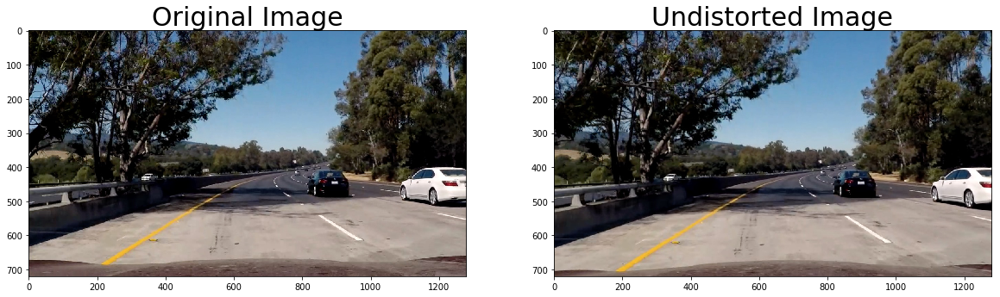

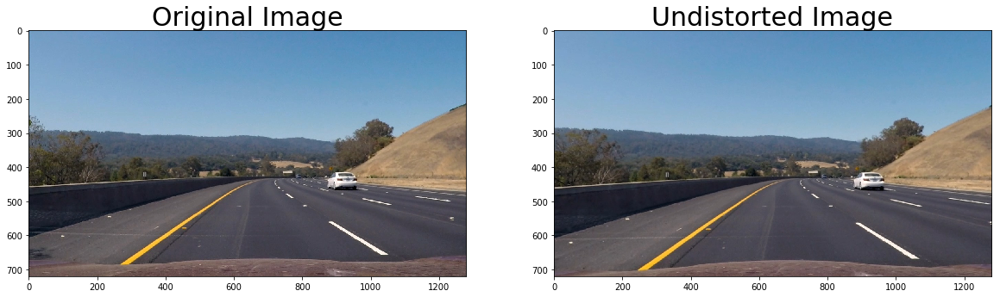

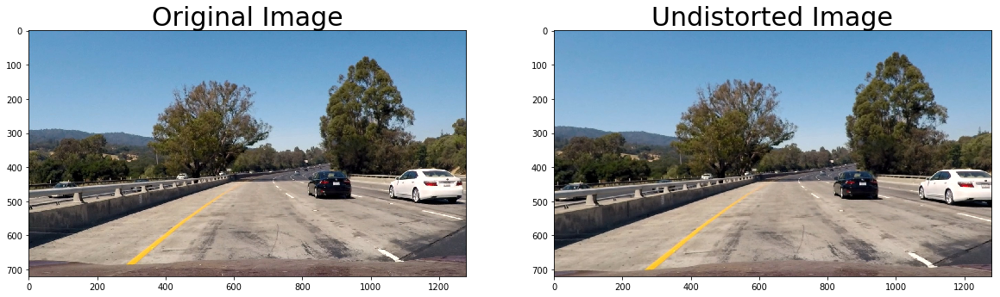

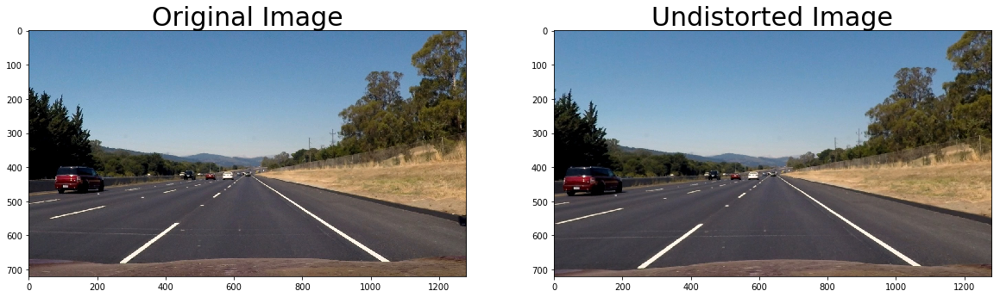

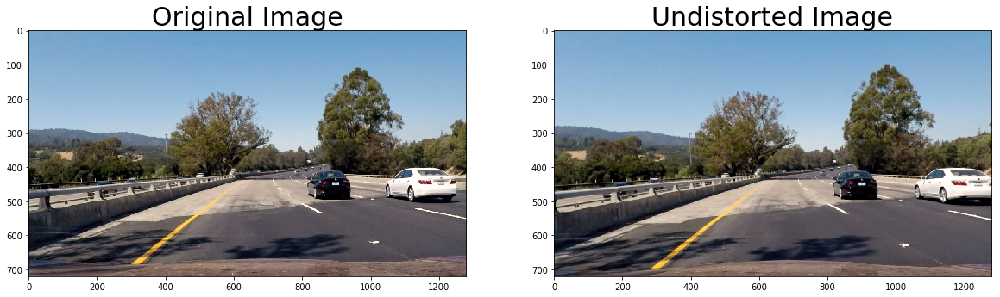

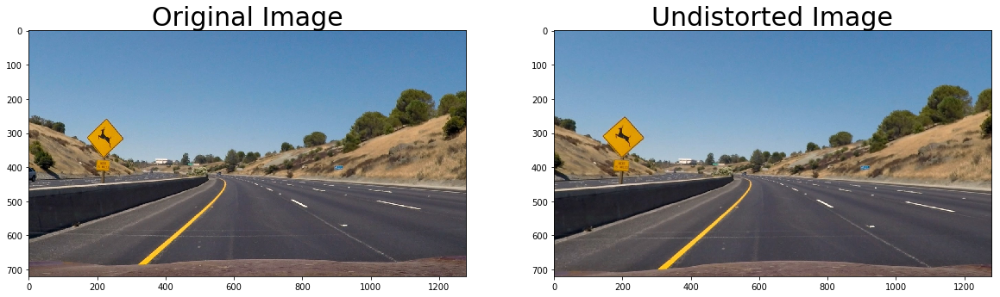

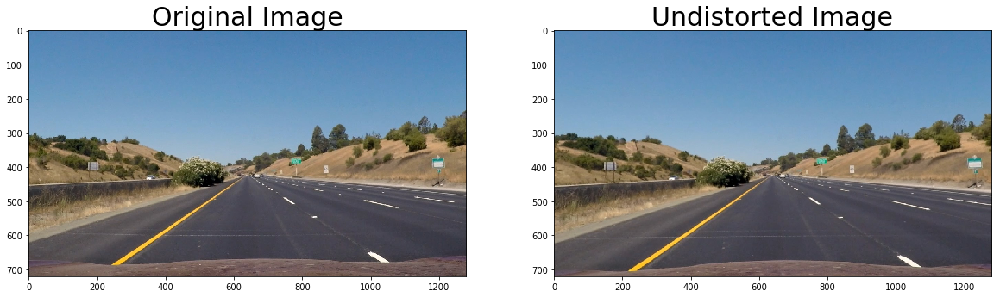

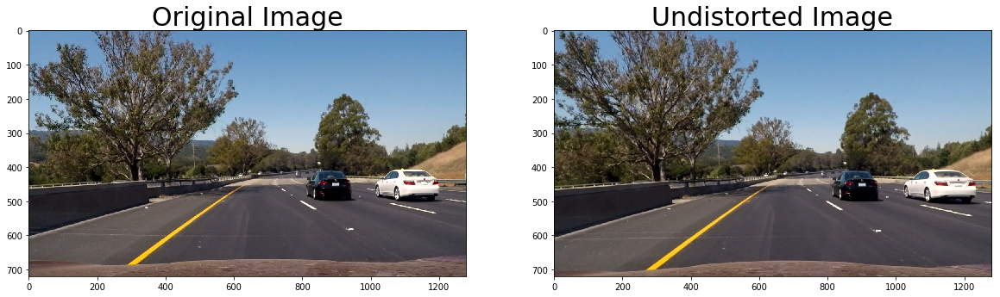

In [19]:
image_in_folder = 'test_images/'
files = [x for x in os.listdir(image_in_folder) if x.endswith('.jpg')]
images = []
for file in files:
    images.append(undistort(mtx,dist,
                            os.path.join(image_in_folder,file),
                            plot = True))

There are many ways to generate a thresholded binary images. Here I first use a gaunssian filter to blur the image and smooth the noise. Then I use sobel operator to find the horizontal edge of the image as lanes are mostly vertical. I also converted the image to HLS space and extract the saturation layer. It works really well for yellow lines because they are high in saturation. I also use the magnitude and direction of gradient to find the edge of the lanes. Finally, I combine three of these approaches and generate a binary image for lane extraction. The following picture shows the result of binary image generation as well as perspective transformation. 

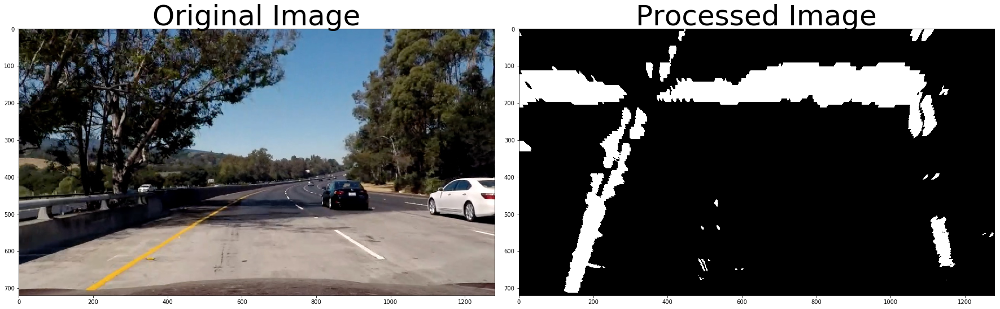

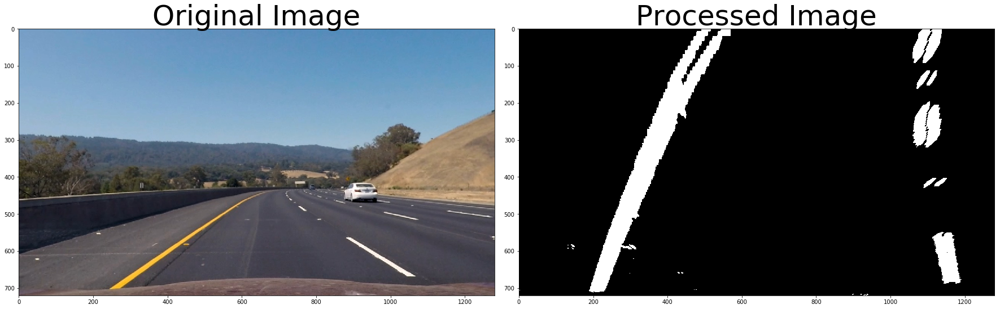

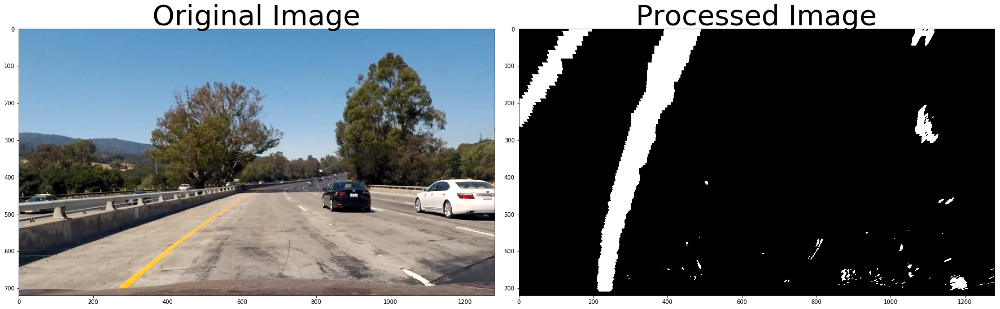

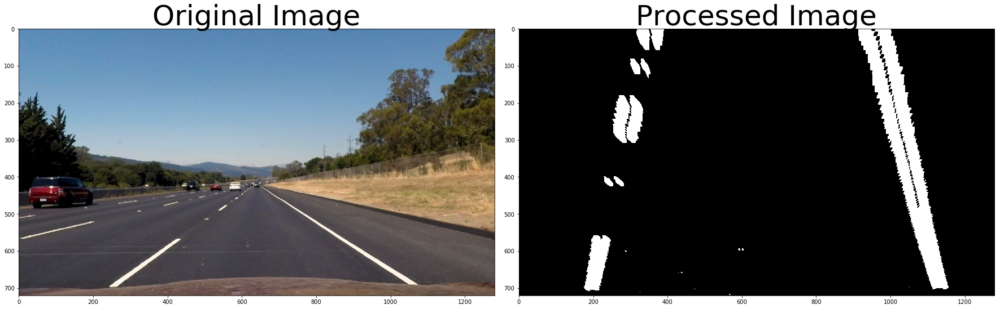

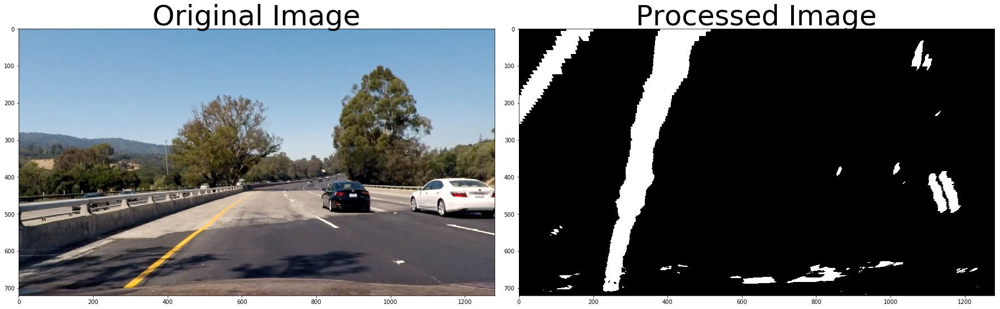

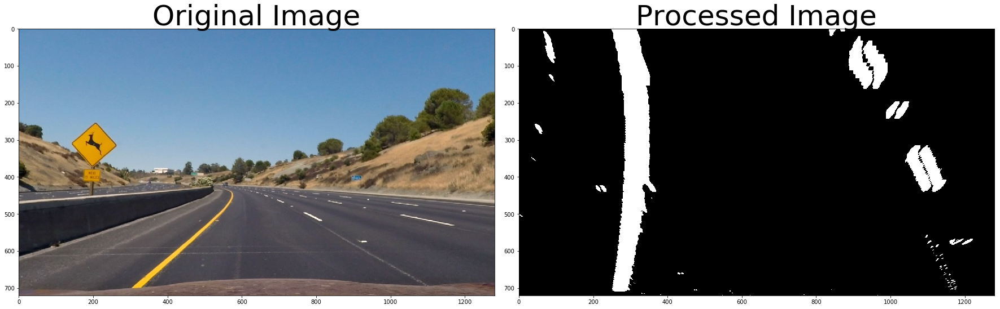

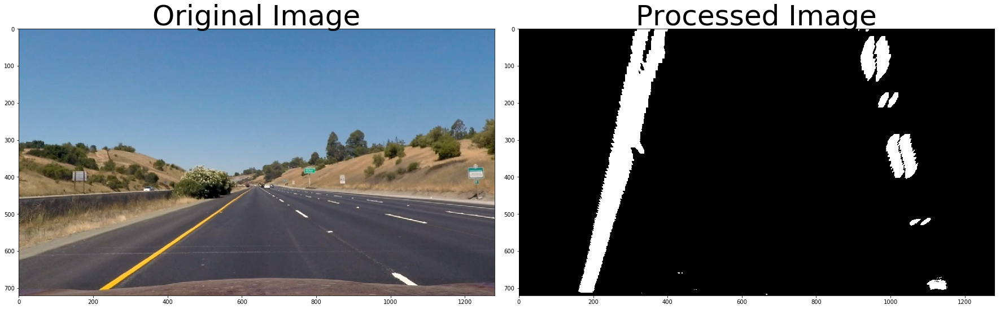

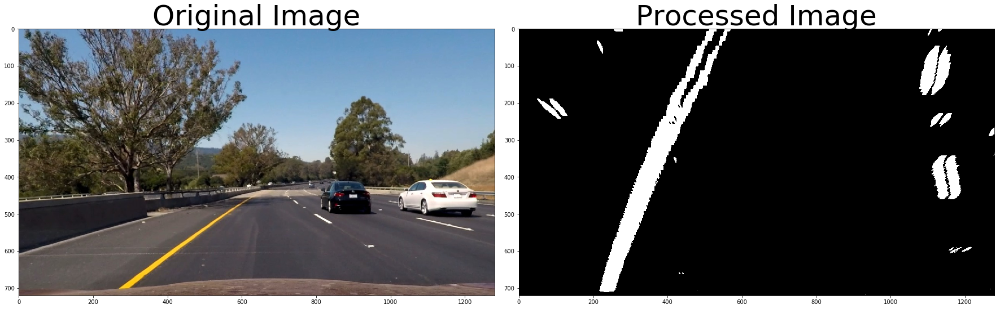

In [20]:
import utils
def select(img):
    filtered = utils.gaussian_blur(img,9)
    s = utils.hls_select(filtered,thresh=(100, 255))
    
    grad_x= utils.abs_sobel_thresh(filtered, 'x',thresh=(32, 255))
    grad_y= utils.abs_sobel_thresh(filtered, 'y',thresh=(32, 255))
    
    dir_bin = utils.dir_thresh(filtered,15, thresh=(0.63, 1.))
    mag_bin = utils.mag_thresh(filtered,15, thresh=(70, 78))

    combined = np.zeros_like(mag_bin)
    combined[((grad_x == 1) ) | 
             ((mag_bin == 1) & (dir_bin == 1)) |
             s > 0] = 1
    
    return combined

for img in images:
    img_bin = select(img)
    warped = cv2.warpPerspective(img_bin, M, img_size, flags=cv2.INTER_LINEAR)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(warped,cmap='gray')
    ax2.set_title('Processed Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    plt.show()

In [21]:
import utils

def poly_fit(img):
    print("Initial search")
    histogram = np.sum(img[int(img.shape[0]/2):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((img, img, img))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines

    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
#     print("left base {},right base {}".format(leftx_base,rightx_base))

    # Choose the number of sliding windows
    nwindows = 10
    # Set height of windows
    window_height = np.int(img.shape[0]/nwindows)
#     print("Using window height {}".format(window_height))

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero  = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

#         # Draw the windows on the visualization image
#         cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 3) 
#         cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 3) 

        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                          (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                           (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]

        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit,right_fit = None,None
    if lefty.any() and leftx.any():
        left_fit = np.polyfit(lefty, leftx, 2)
    if righty.any() and rightx.any():
        right_fit = np.polyfit(righty, rightx, 2)
#     print(left_fit)
#     print(right_fit)
    return left_fit, right_fit


def poly_fit_update(img, left_fit, right_fit):
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & 
                     (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & 
                        (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    left_fit,right_fit = None,None
    if lefty.any() and leftx.any():
        left_fit = np.polyfit(lefty, leftx, 2)
    if righty.any() and rightx.any():
        right_fit = np.polyfit(righty, rightx, 2)
    return left_fit, right_fit

ym_per_pix = 20/720 # meters per pixel in y dimension
xm_per_pix = 2.5/700 # meters per pixel in x dimension
def curvature(poly_fit,y_eval):
    return ((1 +(2*poly_fit[0]*y_eval*ym_per_pix + poly_fit[1])**2)**1.5) / np.absolute(2*poly_fit[0])

        
def draw_lane(img,ploty,left_fitx,right_fitx):
    img_new = img.copy()
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(img).astype(np.uint8)
    color_warp = warp_zero #np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, M_inv, (img.shape[1], img.shape[0])) 
    
    # Combine the result with the original image
    img_new = cv2.addWeighted(img_new, 1, newwarp, 0.3, 0)
    return img_new

def draw_info(img, curv_l, curv_r, dist_l,dist_r):
    img_new = np.copy(img)
    h = img_new.shape[0]
    font = cv2.FONT_HERSHEY_SIMPLEX
    text = 'Curvature Left : {:4.2f}'.format(curv_l) + 'm'
    cv2.putText(img_new, text, (40,70), font, 1, (255,255,255), 2, cv2.LINE_AA)
    text = 'Curvature right : {:4.2f}'.format(curv_r) + 'm'
    
    mean_dist = (dist_l +dist_r)/2
#     print(dist_l +dist_r)
    deviation = ((dist_l - mean_dist) + (mean_dist - dist_r))/2
    cv2.putText(img_new, text, (40,100), font, 1, (255,255,255), 2, cv2.LINE_AA)
    text = 'Deviation to center : {:4.2f}'.format(deviation) + 'm'
    cv2.putText(img_new, text, (40,130), font, 1, (255,255,255), 2, cv2.LINE_AA)
    return img_new
def get_poly_point(poly,x):
    return poly[0]*x*x+poly[1]*x+poly[2]

I define a Line class to store the information of each frame. In each update, I add the new detection into the previous detection and fuse them together to filter out the bad detections and make the result more stable. The method I use is basically a moving average filter. I use a threshold to determine if a new detection is good or bad. If it is good then I update the value with larger weight, if not, then update with smaller weight. The threshold is determined by running the the pipeline without any filtering and calculating the mean polynomial fit coefficient values.

|scenario | Mean polynomial coefficients |
--- | ---
|**curve road** 	L 	|	[  1.18180920e-05   7.80891282e-03   1.51736282e+00]
|        	R 	|	[  4.46696746e-05   3.21652172e-02   7.67916775e+00]
|**straight road** 	L 	|	[  7.57506233e-06   7.05633821e-03   3.65587183e+00]
|             	    R 	|	[  3.13976960e-05   2.05890272e-02   5.05038335e+00]
|**different round** 	L 	|	[  2.59277283e-05   2.85054620e-02   1.19792455e+01]
| 				    R 	|	[  5.60560312e-05   3.47728916e-02   8.93921383e+00]
|**shadow road** 	L 	|	[  3.52839926e-05   3.00916186e-02   1.03260225e+01]
| 				    R 	|	[  1.39808593e-04   1.25237837e-01   3.13900015e+01]

In [29]:
# Define a class to receive the characteristics of each line detection

class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.momemtum = 0.4 
        #radius of curvature of the line in some units
        self.radius_of_curvature = 3000 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        self.diffs_sum = np.array([0,0,0], dtype='float') 
        self.test_count = 0
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        
    def add_poly_fit(self,poly_fit):
#         print("poly_fit",poly_fit)
        if poly_fit == None:
            self.detected = False
        else:
            self.detected = True
            
            if self.best_fit == None:
                self.best_fit = poly_fit
                
            self.diffs = abs(poly_fit - self.best_fit)
            self.diffs_sum = self.diffs_sum + self.diffs
            self.test_count = self.test_count +1
#             print(self.diffs)
            if self.diffs[0] > 1.4e-04 or self.diffs[1] > 1.0e-01 or self.diffs[2] > 20. :
                self.detected = False
                momemtum = self.momemtum * 0.2
#                 print("bad detection",self.diffs)
            else:
                momemtum = self.momemtum
                
            self.best_fit[0] = self.best_fit[0]*(1-momemtum) + poly_fit[0]*momemtum
            self.best_fit[1] = self.best_fit[1]*(1-momemtum) + poly_fit[1]*momemtum
            self.best_fit[2] = self.best_fit[2]*(1-momemtum) + poly_fit[2]*momemtum
#                 print("self.current_fit ",self.current_fit)
    
            # Define y-value where we want radius of curvature
            # I'll choose the maximum y-value, corresponding to the bottom of the image
            y_eval = np.max(ploty)
            self.line_base_pos = abs(get_poly_point(self.best_fit, y_eval)-img_size[0]/2) * xm_per_pix

            # Calculate the new radii of curvature
            curv = curvature(self.best_fit,y_eval)
            self.radius_of_curvature = self.radius_of_curvature *(1-self.momemtum) + self.momemtum*curv

    def mean_diff(self):
        return self.diffs_sum/self.test_count

After all the basic function blocks were built I started to assembled the pipeline. Here are the steps in the pipeline:

1. Undistort the image
2. Binarize the image
3. Transform the image to bird's eye view
4. Use search window and histogram to find the lane pixels
5. Use polynomial fitting algorithm to fit the lane line
6. Calculate the curvature
7. Unwarp the perspective and draw the information

In [23]:
def pipeline(img):
    undistort = cv2.undistort(img, mtx, dist, None, mtx)
    img_bin = select(undistort)
    warped = cv2.warpPerspective(img_bin, M, img_size, flags=cv2.INTER_LINEAR)
    
    if l_line.best_fit == None or r_line.best_fit == None:
        left_fit,right_fit = poly_fit(warped)
    else:
        left_fit,right_fit = poly_fit_update(warped,l_line.best_fit,r_line.best_fit)
     
    l_line.add_poly_fit(left_fit)
    r_line.add_poly_fit(right_fit)
    
    
    # Generate x and y values for plotting
    left_fitx = l_line.best_fit[0]*ploty**2 + l_line.best_fit[1]*ploty + l_line.best_fit[2]
    right_fitx = r_line.best_fit[0]*ploty**2 + r_line.best_fit[1]*ploty + r_line.best_fit[2]
    
    result = draw_lane(undistort,ploty,left_fitx,right_fitx)
    result = draw_info(result,l_line.radius_of_curvature,r_line.radius_of_curvature,
                       l_line.line_base_pos,r_line.line_base_pos)
    return result

def pipeline_resized(img):
    result = pipeline(img)
    return cv2.resize(result, (320, 180))

# img_bin = select(images[0])
# warped = cv2.warpPerspective(img_bin, M, img_size, flags=cv2.INTER_LINEAR)
# f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
# f.tight_layout()
# ax1.imshow(img_bin,cmap='gray')
# ax1.set_title('Original Image', fontsize=50)
# ax2.imshow(warped,cmap='gray')
# ax2.set_title('Processed Image', fontsize=50)
# plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# plt.show()

Initial search


/home/mma/miniconda3/envs/carnd-term1-cpu/lib/python3.5/site-packages/ipykernel_launcher.py:30: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


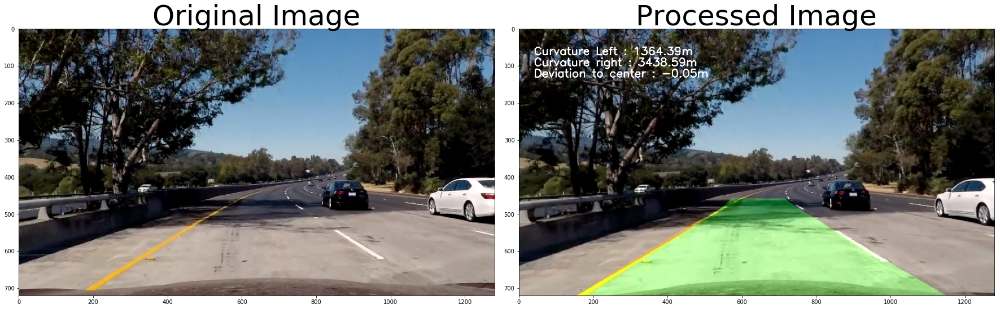

/home/mma/miniconda3/envs/carnd-term1-cpu/lib/python3.5/site-packages/ipykernel_launcher.py:6: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.
  
/home/mma/miniconda3/envs/carnd-term1-cpu/lib/python3.5/site-packages/ipykernel_launcher.py:35: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


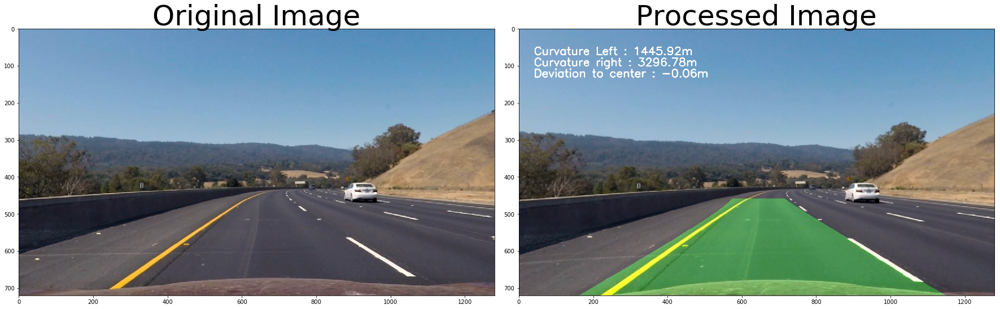

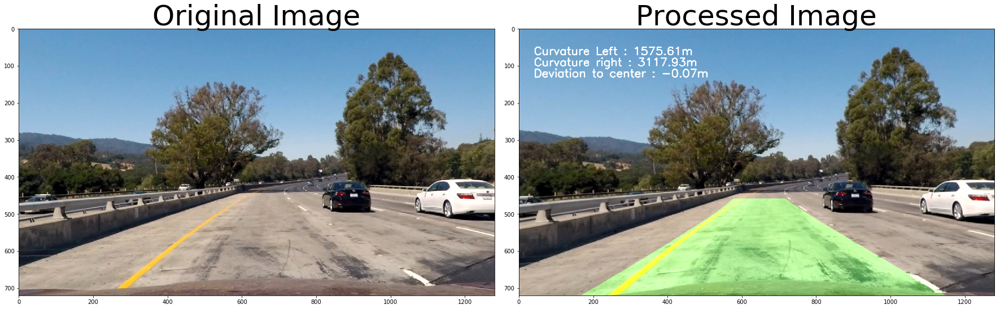

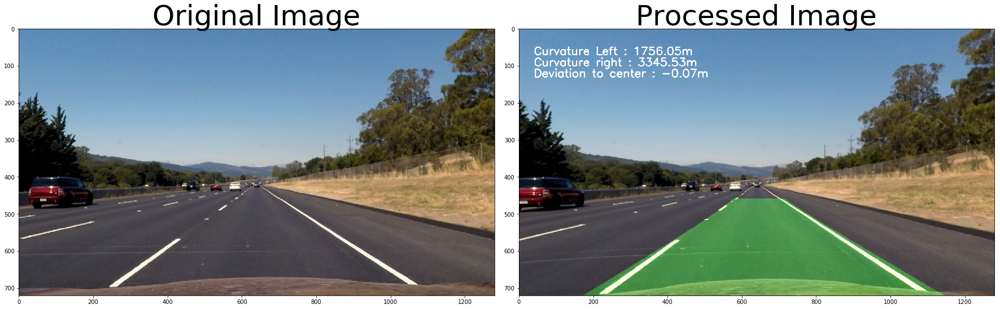

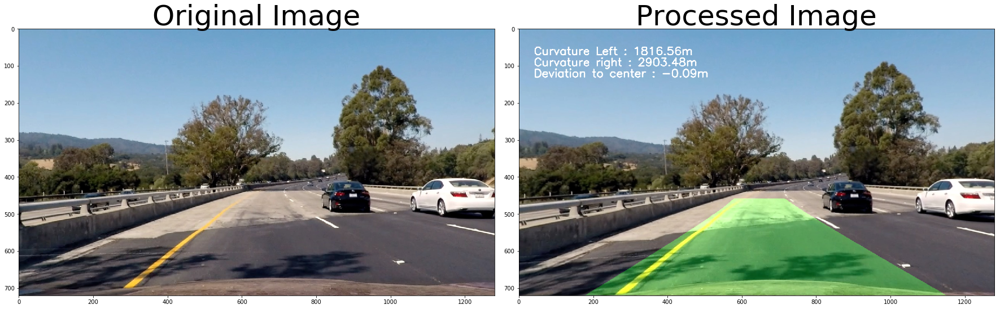

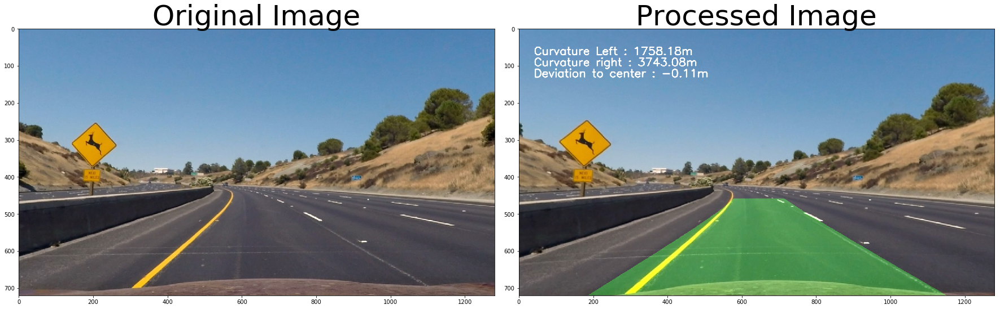

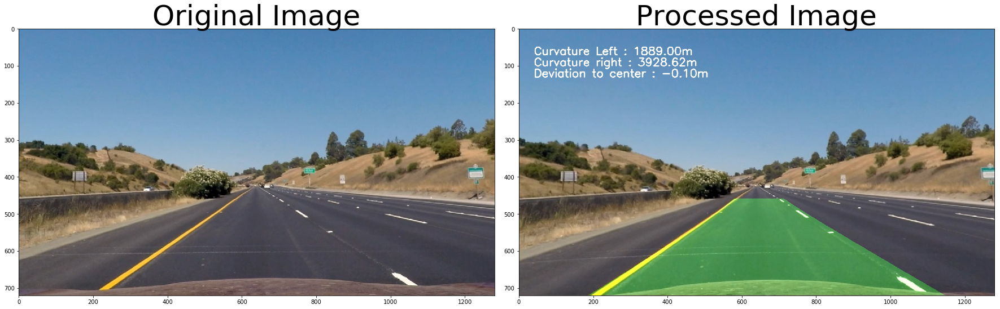

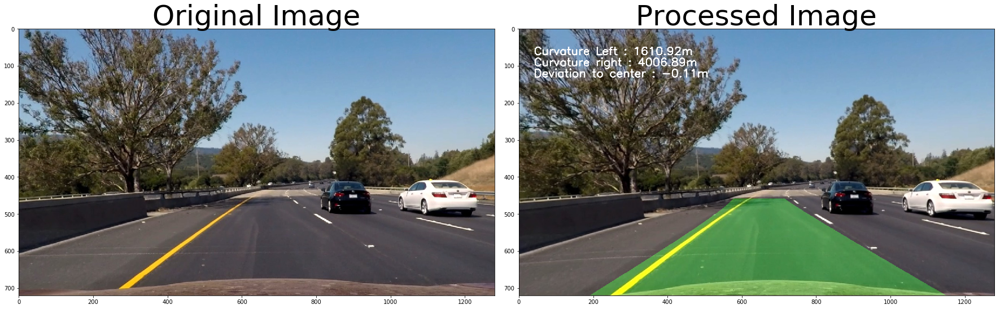

[  2.55722377e-04   2.44434274e-01   6.39441309e+01]
[  1.45768349e-04   1.56849162e-01   6.73050180e+01]


In [24]:
l_line = Line()
r_line = Line()
for image in images:
    image_new = pipeline(image)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(image_new)
    ax2.set_title('Processed Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    plt.show()
    
print(l_line.mean_diff())
print(r_line.mean_diff())

In [11]:
# ym_per_pix = 15/720,xm_per_pix = 2.5/700
print( ym_per_pix,xm_per_pix)

0.020833333333333332 0.0035714285714285713


In [30]:
from moviepy.editor import VideoFileClip
l_line = Line()
r_line = Line()
video_output = 'project_video_output.mp4'
video_input = VideoFileClip('project_video.mp4')
processed_video = video_input.fl_image(pipeline)
processed_video.write_videofile(video_output, audio=False)

Initial search
[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [07:30<00:00,  2.77it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 



In [51]:
print(...)

Ellipsis


In [27]:
"""
Test the curve road
"""
l_line = Line()
r_line = Line()
from moviepy.editor import VideoFileClip

test_output = 'test4.mp4'
test = VideoFileClip('project_video.mp4')
processed_video = test.fl_image(pipeline_resized)
#processed_video.write_videofile(test_output, audio=False)
processed_video.speedx(2.0).write_gif("project_video.gif",fps=8, program='imageio', opt='nq',fuzz=5)

Initial search


TypeError: unsupported operand type(s) for *: 'NoneType' and 'float'